In [7]:
# First let's import the packages we will use in this project
# You can do this all now or as you need them
import pandas as pd
import seaborn as sns
import numpy as np


import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8)

pd.options.mode.chained_assignment = None


In [8]:
df  = pd.read_csv('movies.csv')

In [9]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98


In [10]:
# missing data
for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

name - 0%
rating - 0%
genre - 0%
year - 0%
released - 0%
score - 0%
votes - 0%
director - 0%
writer - 0%
star - 0%
country - 0%
budget - 0%
gross - 0%
company - 0%
runtime - 0%


In [11]:
# Data Types for our columns

print(df.dtypes)

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes         int64
director     object
writer       object
star         object
country      object
budget        int64
gross         int64
company      object
runtime       int64
dtype: object


In [12]:
# change datatype of columns
df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')

In [13]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,0,Drama,2020,"October 23, 2020 (United States)",3.1,18,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,0,0,90
7664,Dream Round,0,Comedy,2020,"February 7, 2020 (United States)",4.7,36,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,0,0,Cactus Blue Entertainment,90
7665,Saving Mbango,0,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,0,Embi Productions,0
7666,It's Just Us,0,Drama,2020,"October 1, 2020 (United States)",0.0,0,James Randall,James Randall,Christina Roz,United States,15000,0,0,120


In [14]:
# create correct year
df['year_correct'] = df['released'].astype(str).str[:4]
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,June
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,July
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,June
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,July
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,July
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,0,Drama,2020,"October 23, 2020 (United States)",3.1,18,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,0,0,90,Octo
7664,Dream Round,0,Comedy,2020,"February 7, 2020 (United States)",4.7,36,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,0,0,Cactus Blue Entertainment,90,Febr
7665,Saving Mbango,0,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,0,Embi Productions,0,Apri
7666,It's Just Us,0,Drama,2020,"October 1, 2020 (United States)",0.0,0,James Randall,James Randall,Christina Roz,United States,15000,0,0,120,Octo


In [15]:
pd.set_option('display.max_rows', None)

In [16]:
# Order our Data a little bit to see

df = df.sort_values(by=['gross'], inplace=False, ascending=False)

In [17]:
# drop any duplicates
df['company'].drop_duplicates().sort_values(ascending = False)

7129                                              thefyzz
5664                                          micro_scope
6412                             iDeal Partners Film Fund
4007                                             i5 Films
6793                                           i am OTHER
6420                                                 erbp
3776                                       double A Films
524                             Zupnik-Curtis Enterprises
3330                          Zucker Brothers Productions
520                                      Zoetrope Studios
2213                                   Zeta Entertainment
6222                        Zentropa International Norway
3698                              Zentropa Entertainments
1175                                 Zenith Entertainment
5180                                      Zazen Produções
3193                                          ZapPictures
1321                             Zanuck/Brown Productions
1329          

In [18]:
# budget high correlation 
# company high correlation

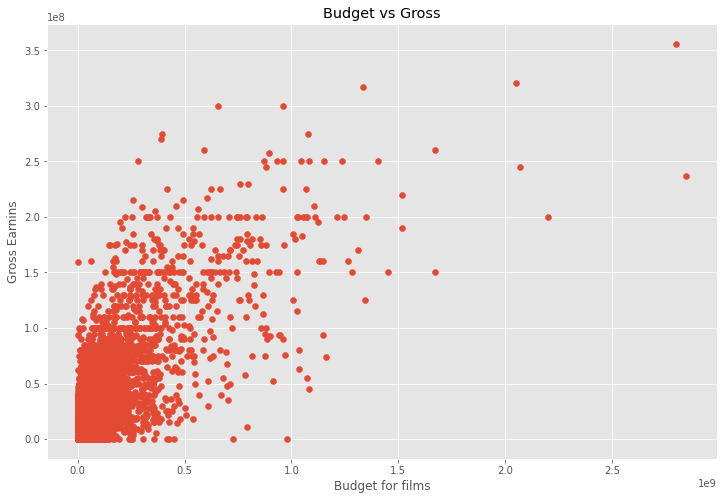

In [19]:
# scatter with budget vs gross
plt.scatter( x= df['gross'], y = df['budget'])
plt.title('Budget vs Gross')
plt.xlabel('Budget for films')
plt.ylabel('Gross Earnins')
plt.show()

In [20]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,Dece
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,Apri
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,Dece
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,Dece
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,Apri


<AxesSubplot:xlabel='budget', ylabel='gross'>

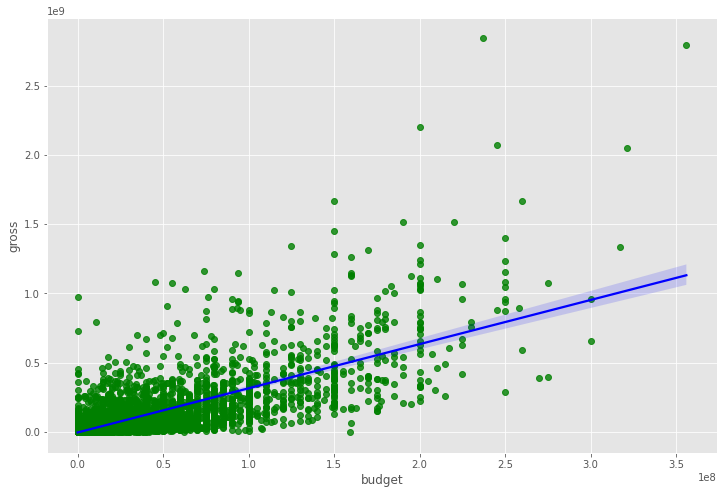

In [21]:
# plot budget vs gross using sns
sns.regplot(x = 'budget', y = 'gross', data = df, scatter_kws={'color' : 'green'}, line_kws = {'color' : "blue"})

In [22]:
# let's start looking at correlation
df.corr() # pearson, kendall, spearman

,year,score,votes,budget,gross,runtime
year,1.000000,0.092616,0.222427,0.309212,0.261900,0.116358
score,0.092616,1.000000,0.407101,0.056863,0.186012,0.394564
votes,0.222427,0.407101,1.000000,0.486931,0.632870,0.306984
budget,0.309212,0.056863,0.486931,1.000000,0.750157,0.268372
gross,0.261900,0.186012,0.632870,0.750157,1.000000,0.244339
runtime,0.116358,0.394564,0.306984,0.268372,0.244339,1.000000


In [23]:
df.corr(method =  'spearman')

,year,score,votes,budget,gross,runtime
year,1.000000,0.097757,0.468107,0.291152,0.314681,0.141805
score,0.097757,1.000000,0.428810,-0.007002,0.133564,0.399868
votes,0.468107,0.428810,1.000000,0.604693,0.752550,0.289359
budget,0.291152,-0.007002,0.604693,1.000000,0.716816,0.246941
gross,0.314681,0.133564,0.752550,0.716816,1.000000,0.257478
runtime,0.141805,0.399868,0.289359,0.246941,0.257478,1.000000


In [24]:
df.corr(method =  'kendall')

,year,score,votes,budget,gross,runtime
year,1.000000,0.066796,0.330410,0.209304,0.216595,0.096390
score,0.066796,1.000000,0.300673,-0.004843,0.091331,0.283601
votes,0.330410,0.300673,1.000000,0.439883,0.560449,0.197697
budget,0.209304,-0.004843,0.439883,1.000000,0.541956,0.176184
gross,0.216595,0.091331,0.560449,0.541956,1.000000,0.177429
runtime,0.096390,0.283601,0.197697,0.176184,0.177429,1.000000


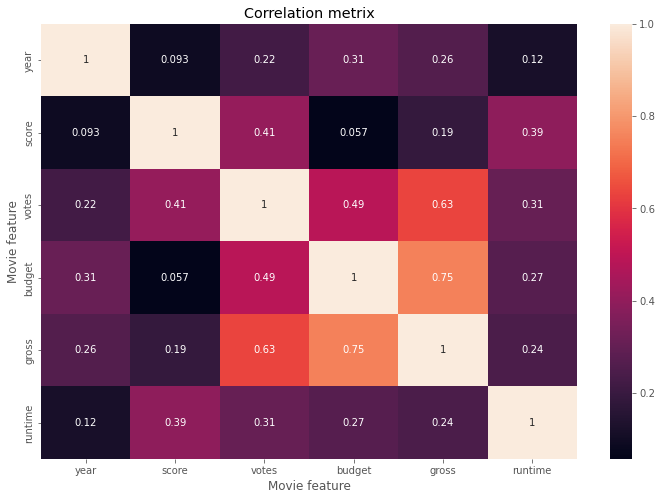

In [25]:
# high correlation between budget and gross
corr_matrix = df.corr(method = 'pearson')
sns.heatmap(corr_matrix, annot = True)
plt.title('Correlation metrix')
plt.xlabel('Movie feature')
plt.ylabel('Movie feature')
plt.show()

In [26]:
# looking at company
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,Dece
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,Apri
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,Dece
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,Dece
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,Apri
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118,July
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124,June
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143,May
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137,Apri
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103,Nove


In [27]:
df_num = df
for col_name in df_num.columns:
    if(df_num[col_name].dtype == 'object'):
        df_num[col_name] = df_num[col_name].astype('category')
        df_num[col_name] = df_num[col_name].cat.codes
        
df_num
# changes all objects to numeric

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
5445,533,6,0,2009,697,7.8,1100000,1155,1779,2335,56,237000000,2847246203,2254,162,11
7445,535,6,0,2019,184,8.4,903000,162,744,2242,56,356000000,2797501328,1607,181,9
3045,6896,6,6,1997,705,7.8,1100000,1155,1779,1596,56,200000000,2201647264,2254,194,11
6663,5144,6,0,2015,699,7.8,876000,1125,2551,525,56,245000000,2069521700,1541,138,11
7244,536,6,0,2018,193,8.4,897000,162,744,2242,56,321000000,2048359754,1607,149,9
7480,6194,5,2,2019,1489,6.9,222000,1455,1920,677,56,260000000,1670727580,2317,118,14
6653,2969,6,0,2015,1705,7.0,593000,517,3569,438,56,150000000,1670516444,2282,124,15
6043,5502,6,0,2012,2473,8.0,1300000,1517,2315,2242,56,220000000,1518815515,1607,143,17
6646,2145,6,0,2015,222,7.1,370000,1189,707,2722,56,190000000,1515341399,2282,137,9
7494,2131,5,2,2019,2677,6.8,148000,432,1951,1528,56,150000000,1450026933,2316,103,18


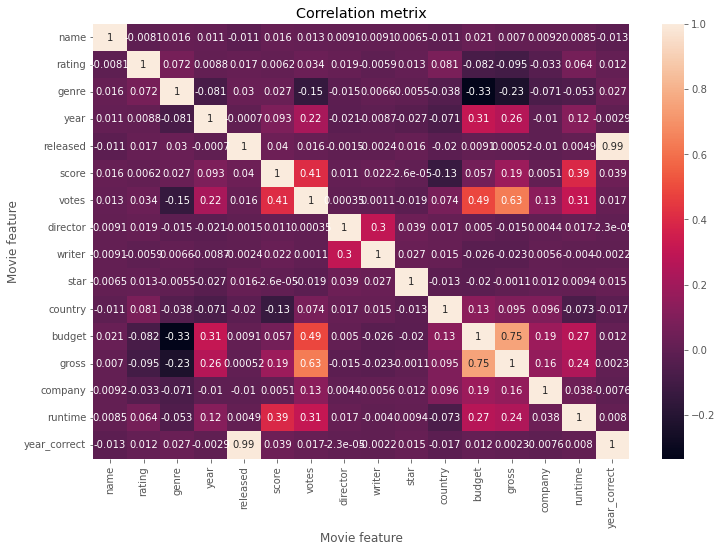

In [28]:
corr_matrix = df_num.corr(method = 'pearson')
sns.heatmap(corr_matrix, annot = True)
plt.title('Correlation metrix')
plt.xlabel('Movie feature')
plt.ylabel('Movie feature')
plt.show()

In [29]:
df_num.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
name,1.000000,-0.008069,0.016355,0.011453,-0.011311,0.016377,0.013038,0.009079,0.009081,0.006472,-0.010737,0.020548,0.006989,0.009212,0.008483,-0.013132
rating,-0.008069,1.000000,0.072423,0.008779,0.016613,0.006192,0.033743,0.019483,-0.005920,0.013404,0.081244,-0.081939,-0.095450,-0.032954,0.064133,0.012429
genre,0.016355,0.072423,1.000000,-0.081261,0.029822,0.027384,-0.145296,-0.015258,0.006567,-0.005477,-0.037615,-0.334021,-0.234297,-0.071066,-0.052914,0.027305
year,0.011453,0.008779,-0.081261,1.000000,-0.000695,0.092616,0.222427,-0.020795,-0.008655,-0.027242,-0.070938,0.309212,0.261900,-0.010433,0.116358,-0.002885
released,-0.011311,0.016613,0.029822,-0.000695,1.000000,0.039814,0.015878,-0.001478,-0.002404,0.015776,-0.020427,0.009145,0.000519,-0.010471,0.004852,0.994590
score,0.016377,0.006192,0.027384,0.092616,0.039814,1.000000,0.407101,0.010568,0.022098,-0.000026,-0.133346,0.056863,0.186012,0.005067,0.394564,0.038923
votes,0.013038,0.033743,-0.145296,0.222427,0.015878,0.407101,1.000000,0.000349,0.001126,-0.019146,0.073525,0.486931,0.632870,0.133455,0.306984,0.016978
director,0.009079,0.019483,-0.015258,-0.020795,-0.001478,0.010568,0.000349,1.000000,0.299067,0.039234,0.017490,0.004976,-0.014916,0.004404,0.017062,-0.000023
writer,0.009081,-0.005920,0.006567,-0.008655,-0.002404,0.022098,0.001126,0.299067,1.000000,0.027246,0.015342,-0.025912,-0.022997,0.005644,-0.004036,-0.002235
star,0.006472,0.013404,-0.005477,-0.027242,0.015776,-0.000026,-0.019146,0.039234,0.027246,1.000000,-0.012999,-0.019952,-0.001129,0.012437,0.009418,0.015330


In [30]:
corr_mat =  df_num.corr()
corr_pairs = corr_mat.unstack()

corr_pairs

name          name            1.000000
              rating         -0.008069
              genre           0.016355
              year            0.011453
              released       -0.011311
              score           0.016377
              votes           0.013038
              director        0.009079
              writer          0.009081
              star            0.006472
              country        -0.010737
              budget          0.020548
              gross           0.006989
              company         0.009212
              runtime         0.008483
              year_correct   -0.013132
rating        name           -0.008069
              rating          1.000000
              genre           0.072423
              year            0.008779
              released        0.016613
              score           0.006192
              votes           0.033743
              director        0.019483
              writer         -0.005920
              star       

In [31]:
sorted_pairs = corr_pairs.sort_values()

sorted_pairs

budget        genre          -0.334021
genre         budget         -0.334021
gross         genre          -0.234297
genre         gross          -0.234297
votes         genre          -0.145296
genre         votes          -0.145296
country       score          -0.133346
score         country        -0.133346
rating        gross          -0.095450
gross         rating         -0.095450
budget        rating         -0.081939
rating        budget         -0.081939
year          genre          -0.081261
genre         year           -0.081261
runtime       country        -0.073319
country       runtime        -0.073319
company       genre          -0.071066
genre         company        -0.071066
country       year           -0.070938
year          country        -0.070938
genre         runtime        -0.052914
runtime       genre          -0.052914
genre         country        -0.037615
country       genre          -0.037615
company       rating         -0.032954
rating        company    

In [32]:
high_corr = sorted_pairs[(sorted_pairs) > 0.5]
high_corr

gross         votes           0.632870
votes         gross           0.632870
budget        gross           0.750157
gross         budget          0.750157
year_correct  released        0.994590
released      year_correct    0.994590
name          name            1.000000
company       company         1.000000
gross         gross           1.000000
budget        budget          1.000000
country       country         1.000000
star          star            1.000000
writer        writer          1.000000
director      director        1.000000
votes         votes           1.000000
score         score           1.000000
released      released        1.000000
year          year            1.000000
genre         genre           1.000000
rating        rating          1.000000
runtime       runtime         1.000000
year_correct  year_correct    1.000000
dtype: float64

In [33]:
# votes and budget have high correlation to gross earnings
 # company has low correlation

<AxesSubplot:>

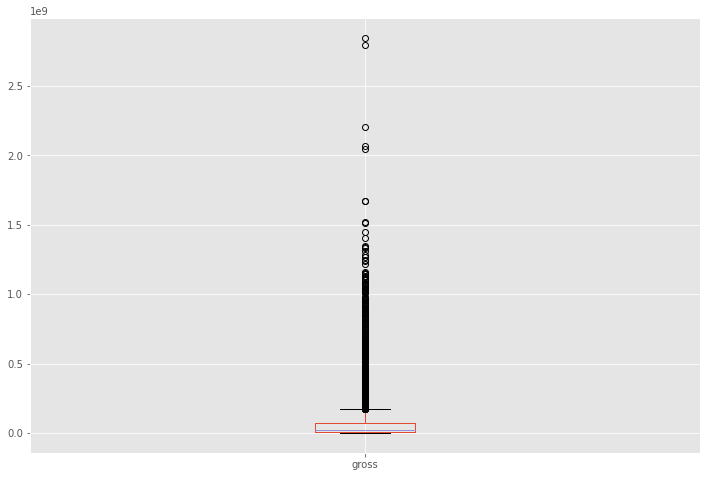

In [34]:
# Are there any Outliers?
# different

df.boxplot(column=['gross'])

<AxesSubplot:xlabel='score', ylabel='gross'>

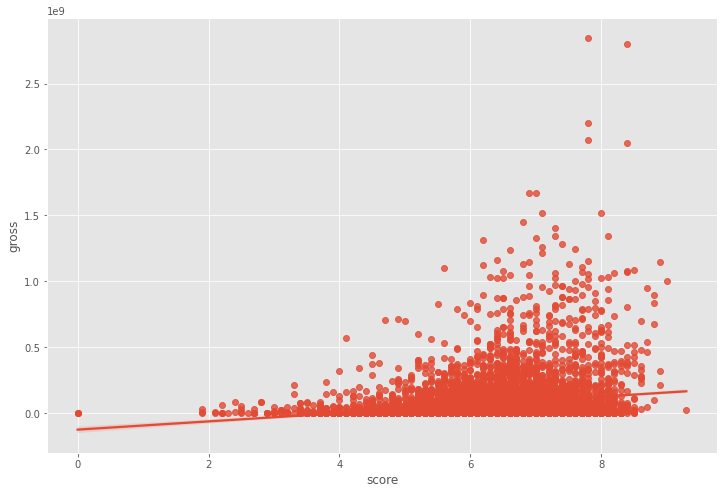

In [35]:
sns.regplot(x="score", y="gross", data=df)

In [36]:
# Using factorize - this assigns a random numeric value for each unique categorical value

df.apply(lambda x: x.factorize()[0]).corr(method='pearson')

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct
name,1.000000,0.344538,0.138367,0.253906,0.656262,0.110209,0.599044,0.720119,0.782929,0.653260,0.193910,0.111217,0.978147,0.686234,0.074640,0.111462
rating,0.344538,1.000000,-0.014784,0.036004,0.263736,-0.065247,0.157686,0.283992,0.303181,0.303931,0.199683,0.083569,0.351587,0.334664,0.035324,0.077676
genre,0.138367,-0.014784,1.000000,0.087977,0.090957,0.061146,0.146753,0.093457,0.088192,0.099710,-0.072434,0.101274,0.134001,0.057761,0.003925,-0.018312
year,0.253906,0.036004,0.087977,1.000000,0.315368,0.078953,0.328794,0.173235,0.212396,0.228048,-0.055861,0.060244,0.266957,0.123375,0.032265,0.001234
released,0.656262,0.263736,0.090957,0.315368,1.000000,0.071617,0.452182,0.502084,0.546858,0.476483,0.163594,0.080321,0.669825,0.467309,0.050231,0.141713
score,0.110209,-0.065247,0.061146,0.078953,0.071617,1.000000,0.234713,0.151672,0.107603,0.111690,-0.096042,0.005856,0.116466,0.039431,0.038637,0.027670
votes,0.599044,0.157686,0.146753,0.328794,0.452182,0.234713,1.000000,0.497335,0.525249,0.456987,0.050474,0.042931,0.615089,0.394729,0.070017,0.080159
director,0.720119,0.283992,0.093457,0.173235,0.502084,0.151672,0.497335,1.000000,0.696227,0.581049,0.195451,0.043335,0.737284,0.616906,0.080564,0.081343
writer,0.782929,0.303181,0.088192,0.212396,0.546858,0.107603,0.525249,0.696227,1.000000,0.590607,0.198955,0.064066,0.797865,0.618775,0.057833,0.077505
star,0.653260,0.303931,0.099710,0.228048,0.476483,0.111690,0.456987,0.581049,0.590607,1.000000,0.220061,0.066901,0.669963,0.573670,0.074647,0.065706


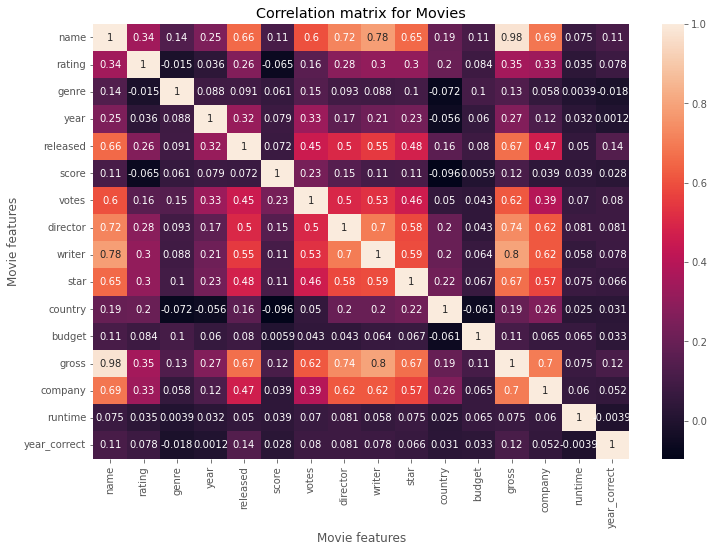

In [37]:
 
correlation_matrix = df.apply(lambda x: x.factorize()[0]).corr(method='pearson')

sns.heatmap(correlation_matrix, annot = True)

plt.title("Correlation matrix for Movies")

plt.xlabel("Movie features")

plt.ylabel("Movie features")

plt.show()

In [38]:
correlation_mat = df.apply(lambda x: x.factorize()[0]).corr()

corr_pairs = correlation_mat.unstack()

print(corr_pairs)

name          name            1.000000
              rating          0.344538
              genre           0.138367
              year            0.253906
              released        0.656262
              score           0.110209
              votes           0.599044
              director        0.720119
              writer          0.782929
              star            0.653260
              country         0.193910
              budget          0.111217
              gross           0.978147
              company         0.686234
              runtime         0.074640
              year_correct    0.111462
rating        name            0.344538
              rating          1.000000
              genre          -0.014784
              year            0.036004
              released        0.263736
              score          -0.065247
              votes           0.157686
              director        0.283992
              writer          0.303181
              star       

In [39]:
sorted_pairs = corr_pairs.sort_values(kind="quicksort")

print(sorted_pairs)

country       score          -0.096042
score         country        -0.096042
country       genre          -0.072434
genre         country        -0.072434
rating        score          -0.065247
score         rating         -0.065247
country       budget         -0.060810
budget        country        -0.060810
year          country        -0.055861
country       year           -0.055861
genre         year_correct   -0.018312
year_correct  genre          -0.018312
rating        genre          -0.014784
genre         rating         -0.014784
runtime       year_correct   -0.003935
year_correct  runtime        -0.003935
              year            0.001234
year          year_correct    0.001234
runtime       genre           0.003925
genre         runtime         0.003925
budget        score           0.005856
score         budget          0.005856
runtime       country         0.024827
country       runtime         0.024827
year_correct  score           0.027670
score         year_correc

In [40]:
# Looking at the top 15 compaies by gross revenue

CompanyGrossSum = df.groupby('company')[["gross"]].sum()

CompanyGrossSumSorted = CompanyGrossSum.sort_values('gross', ascending = False)[:15]

CompanyGrossSumSorted = CompanyGrossSumSorted['gross'].astype('int64') 

CompanyGrossSumSorted

company
2320    56491421806
2282    52514188890
732     43008941346
1813    40493607415
2254    40257053857
2317    36327887792
1714    19883797684
1607    15065592411
888     11873612858
2233    11795832638
890     11635441081
1638     9230230105
2148     8373718838
1857     7886344526
1110     7443502667
Name: gross, dtype: int64

In [41]:
df['Year'] = df['released'].astype(str).str[:4]
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,Year
5445,533,6,0,2009,697,7.8,1100000,1155,1779,2335,56,237000000,2847246203,2254,162,11,697
7445,535,6,0,2019,184,8.4,903000,162,744,2242,56,356000000,2797501328,1607,181,9,184
3045,6896,6,6,1997,705,7.8,1100000,1155,1779,1596,56,200000000,2201647264,2254,194,11,705
6663,5144,6,0,2015,699,7.8,876000,1125,2551,525,56,245000000,2069521700,1541,138,11,699
7244,536,6,0,2018,193,8.4,897000,162,744,2242,56,321000000,2048359754,1607,149,9,193
7480,6194,5,2,2019,1489,6.9,222000,1455,1920,677,56,260000000,1670727580,2317,118,14,1489
6653,2969,6,0,2015,1705,7.0,593000,517,3569,438,56,150000000,1670516444,2282,124,15,1705
6043,5502,6,0,2012,2473,8.0,1300000,1517,2315,2242,56,220000000,1518815515,1607,143,17,2473
6646,2145,6,0,2015,222,7.1,370000,1189,707,2722,56,190000000,1515341399,2282,137,9,222
7494,2131,5,2,2019,2677,6.8,148000,432,1951,1528,56,150000000,1450026933,2316,103,18,2677


In [42]:
df.groupby(['company', 'year'])[["gross"]].sum()

gross
company year            
0       2003    44350926
1       2019   193457467
2       1996       10580
3       1983     5563663
        1984     2687148
        1986     3102082
        1989     6693304
        1990     1510053
        2010           0
        2019      103047
        2020    25818882
4       2000     1196218
5       2010      814906
6       2002     6479328
7       2009       26676
        2016      368372
8       2000       25461
9       1996   129832389
        1999    87423861
10      1983    12232628
11      2003     4928883
12      2017    40656399
13      2014    58834384
14      1995     4686937
15      2002      264349
16      2019   122810399
17      2007    22783978
18      2004    69424389
19      2020   111105497
20      2014    41296320
        2018    41142379
21      1989     3953745
        1990     7658401
22      1994     1702394
23      2002    23932055
24      2009    20458873
25      2007     7248490
        2008    28705178
        2014     5092129
26      2016      678150
        2018   197744377
27      1996    60209334
        1997    75812433
        2001    71186502
        2010      649626
        2013     3909596
        2014   161459297
        2015    36606743
        2019    22386555
28      1999     8408835
29      2013     3114953
        2017     5042014
30      2007     9669758
31      1998     1960216
        1999       92442
32      1999           0
        2003      167999
33      2001     4760014
34      2006     1297260
35      1999   133949270
36      1986     7137502
        1989    37295445
        1995    15403436
        1999    34573780
        2000    27728118
        2004     1526951
37      1999       60279
38      2007    95802916
39      2001      270811
40      1999      206128
41      1987      519596
        2000     3033646
42      2019       38901
43      2012     1944287
44      1990    10005969
45      1990   201965915
46      2003     5141166
47      2002    80693537
48      1995     3734870
        1996       49620
        2002    14946150
49      2010     3843774
50      2012    23812816
51      2007      185699
52      1984     1455045
        1985    10297601
        1986    13431806
        1988      161004
        1989     8247542
        1991       30964
        1992     1526697
        1993     2000678
53      1991     4532791
54      2014    36869414
        2016    72551409
        2018    23650455
        2019    70728705
55      2018    33748006
56      1985     6565359
57      1982    40743010
        1983    35615609
        1984    26632815
        1985    26657534
        1986     9697739
58      1996    17100266
59      2019      271101
60      1984     1525532
61      1990      349618
62      2016    31668920
63      2016    39712000
        2017    53939297
64      2005    12693645
65      1989       67878
66      1984    52066791
        1998     1263279
        1999     1632567
67      2018    67999335
68      2013    17496820
69      1995      228800
        1999           0
70      1998           0
        1999      293092
        2000    60726164
71      1996     3828405
        1998     7120568
        2001     6781952
        2016     6953604
72      2014    25419147
73      2007      719968
74      2019    35261263
75      1980    21448782
        1981    25244626
        1982    13253583
76      2001     1724806
        2007    21897373
        2012     5277766
        2016   303723636
77      2000   224834564
        2005   194137091
        2006   178281554
78      1989     3169719
79      1986      441863
        1987     3685862
80      2008    87066930
81      2001      384098
82      1994           0
        1997       10923
83      2013     1456675
84      2020           0
85      2019   119932733
86      2004      217499
87      2012   116471580
88      1988     4192440
89      2017    43980821
        2018     3915207
90      1982     3783329
91      2018   117679066
92      2019    25775371
93      1983    146

In [43]:
CompanyGrossSum = df.groupby(['company', 'year'])[["gross"]].sum()

CompanyGrossSumSorted = CompanyGrossSum.sort_values(['gross','company','year'], ascending = False)[:15]

CompanyGrossSumSorted = CompanyGrossSumSorted['gross'].astype('int64') 

CompanyGrossSumSorted

company  year
2317     2019    5773131804
1607     2018    4018631866
2282     2015    3834354888
2254     2009    3793491246
2317     2017    3789382071
1813     2011    3565705182
2320     2010    3300479986
         2011    3223799224
2317     2010    3104474158
1813     2014    3071298586
732      2006    2934631933
         2019    2932757449
1607     2019    2797501328
2320     2018    2774168962
732      2011    2738363306
Name: gross, dtype: int64

In [44]:
CompanyGrossSum = df.groupby(['company'])[["gross"]].sum()

CompanyGrossSumSorted = CompanyGrossSum.sort_values(['gross','company'], ascending = False)[:15]

CompanyGrossSumSorted = CompanyGrossSumSorted['gross'].astype('int64') 

CompanyGrossSumSorted

company
2320    56491421806
2282    52514188890
732     43008941346
1813    40493607415
2254    40257053857
2317    36327887792
1714    19883797684
1607    15065592411
888     11873612858
2233    11795832638
890     11635441081
1638     9230230105
2148     8373718838
1857     7886344526
1110     7443502667
Name: gross, dtype: int64

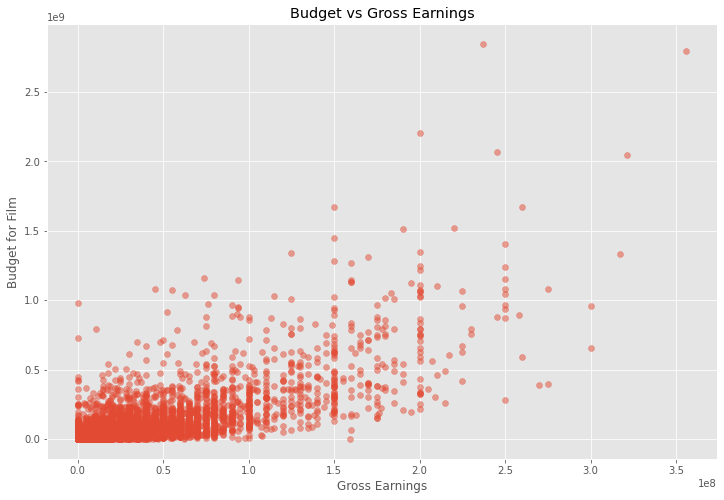

In [45]:
plt.scatter(x=df['budget'], y=df['gross'], alpha=0.5)
plt.title('Budget vs Gross Earnings')
plt.xlabel('Gross Earnings')
plt.ylabel('Budget for Film')
plt.show()